In [ ]:
import numpy as np
import pandas as pd
! pip install sidetable
import sidetable
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 1.7 MB/s eta 0:00:00


In [ ]:
# load data
df = pd.read_csv('/content/data.csv')
df.head()

,TransactionId,BatchId,AccountId,SubscriptionId,CustomerId,CurrencyCode,CountryCode,ProviderId,ProductId,ProductCategory,ChannelId,Amount,Value,TransactionStartTime,PricingStrategy,FraudResult
0,TransactionId_76871,BatchId_36123,AccountId_3957,SubscriptionId_887,CustomerId_4406,UGX,256,ProviderId_6,ProductId_10,airtime,ChannelId_3,1000.0,1000,2018-11-15T02:18:49Z,2,0
1,TransactionId_73770,BatchId_15642,AccountId_4841,SubscriptionId_3829,CustomerId_4406,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-20.0,20,2018-11-15T02:19:08Z,2,0
2,TransactionId_26203,BatchId_53941,AccountId_4229,SubscriptionId_222,CustomerId_4683,UGX,256,ProviderId_6,ProductId_1,airtime,ChannelId_3,500.0,500,2018-11-15T02:44:21Z,2,0
3,TransactionId_380,BatchId_102363,AccountId_648,SubscriptionId_2185,CustomerId_988,UGX,256,ProviderId_1,ProductId_21,utility_bill,ChannelId_3,20000.0,21800,2018-11-15T03:32:55Z,2,0
4,TransactionId_28195,BatchId_38780,AccountId_4841,SubscriptionId_3829,CustomerId_988,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-644.0,644,2018-11-15T03:34:21Z,2,0


Explanation of Variables
BAD: Target variable indicating whether the individual defaulted on a loan (1 for default, 0 for non-default).

LOAN: The total amount of the loan taken by the individual.

MORTDUE: The amount overdue on the mortgage, reflecting the current outstanding balance or overdue payments.

VALUE: The appraised value of the property or asset against which the loan is secured.

REASON: A categorical variable indicating the reason for taking the loan (e.g., home purchase, debt consolidation).

JOB: A categorical variable representing the job status or occupation of the individual.

YOJ (Years on Job): The number of years the individual has been employed in their current job, indicating job stability.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95662 entries, 0 to 95661
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   TransactionId         95662 non-null  object 
 1   BatchId               95662 non-null  object 
 2   AccountId             95662 non-null  object 
 3   SubscriptionId        95662 non-null  object 
 4   CustomerId            95662 non-null  object 
 5   CurrencyCode          95662 non-null  object 
 6   CountryCode           95662 non-null  int64  
 7   ProviderId            95662 non-null  object 
 8   ProductId             95662 non-null  object 
 9   ProductCategory       95662 non-null  object 
 10  ChannelId             95662 non-null  object 
 11  Amount                95662 non-null  float64
 12  Value                 95662 non-null  int64  
 13  TransactionStartTime  95662 non-null  object 
 14  PricingStrategy       95662 non-null  int64  
 15  FraudResult        

In [ ]:
# check target balance (TransactionId)
df.stb.freq(['TransactionId'], style = True)

,TransactionId,count,percent,cumulative_count,cumulative_percent
0,TransactionId_99999,1,0.00%,1,0.00%
1,TransactionId_99997,1,0.00%,2,0.00%
2,TransactionId_99994,1,0.00%,3,0.00%
3,TransactionId_99993,1,0.00%,4,0.00%
4,TransactionId_9999,1,0.00%,5,0.01%
5,TransactionId_99988,1,0.00%,6,0.01%
6,TransactionId_99986,1,0.00%,7,0.01%
7,TransactionId_99985,1,0.00%,8,0.01%
8,TransactionId_99984,1,0.00%,9,0.01%
9,TransactionId_99983,1,0.00%,10,0.01%


In [ ]:
# CountryCode - check categories
df.stb.freq(['CountryCode'], style = True)

,CountryCode,count,percent,cumulative_count,cumulative_percent
0,256,"95,662",100.00%,"95,662",100.00%


Categories:

DebtCon: Refers to loans taken for debt consolidation.
HomeImp: Refers to loans taken for home improvement.

In [ ]:
# ProductCategory - check categories
df.stb.freq(['ProductCategory'], style = True)

,ProductCategory,count,percent,cumulative_count,cumulative_percent
0,financial_services,"45,405",47.46%,"45,405",47.46%
1,airtime,"45,027",47.07%,"90,432",94.53%
2,utility_bill,"1,920",2.01%,"92,352",96.54%
3,data_bundles,"1,613",1.69%,"93,965",98.23%
4,tv,"1,279",1.34%,"95,244",99.56%
5,ticket,216,0.23%,"95,460",99.79%
6,movies,175,0.18%,"95,635",99.97%
7,transport,25,0.03%,"95,660",100.00%
8,other,2,0.00%,"95,662",100.00%


In [ ]:
# Check numeric variables
df.describe()

,CountryCode,Amount,Value,PricingStrategy,FraudResult
count,95662.0,9.566200e+04,9.566200e+04,95662.000000,95662.000000
mean,256.0,6.717846e+03,9.900584e+03,2.255974,0.002018
std,0.0,1.233068e+05,1.231221e+05,0.732924,0.044872
min,256.0,-1.000000e+06,2.000000e+00,0.000000,0.000000
25%,256.0,-5.000000e+01,2.750000e+02,2.000000,0.000000
50%,256.0,1.000000e+03,1.000000e+03,2.000000,0.000000
75%,256.0,2.800000e+03,5.000000e+03,2.000000,0.000000
max,256.0,9.880000e+06,9.880000e+06,4.000000,1.000000


In [ ]:
# missing check
df.stb.missing()

,missing,total,percent
TransactionId,0,95662,0.0
BatchId,0,95662,0.0
AccountId,0,95662,0.0
SubscriptionId,0,95662,0.0
CustomerId,0,95662,0.0
CurrencyCode,0,95662,0.0
CountryCode,0,95662,0.0
ProviderId,0,95662,0.0
ProductId,0,95662,0.0
ProductCategory,0,95662,0.0


Unvariate analysis

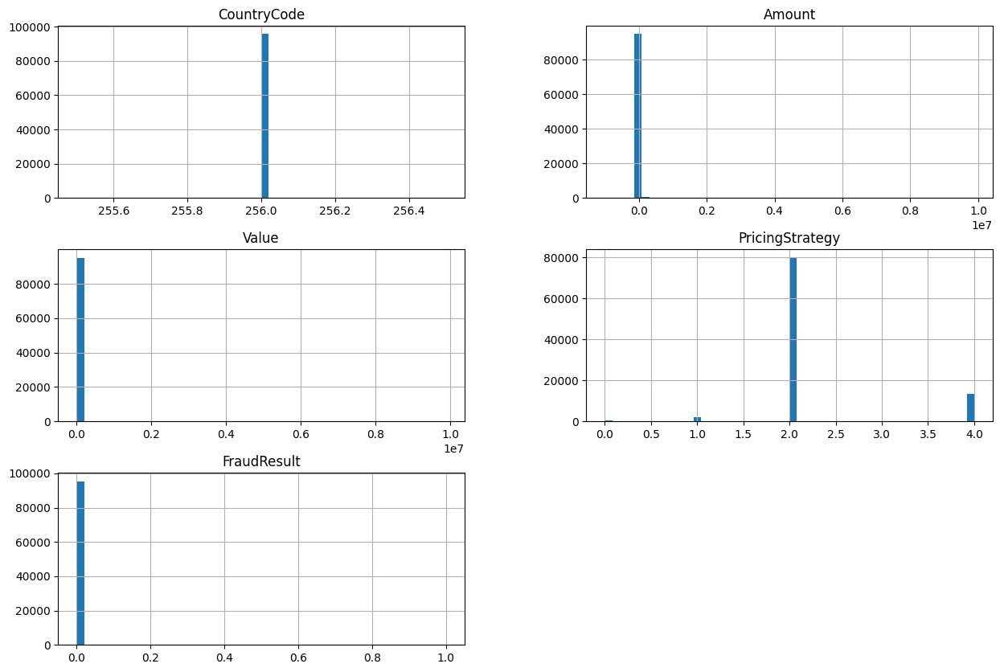

In [ ]:
# distribution plots - Histograms
df_num = df.select_dtypes(include = ['float64', 'int64'])
df_num.hist(figsize = (15, 10), bins = 50);

In [ ]:
# TransactionId
## Let's fill missing values with the residual category
df['TransactionId'] = df['TransactionId'].fillna(value = 'Other')

Bivariate Analysis

In [ ]:
# Selecting only numeric variables
numeric_df = df.select_dtypes(include=['number'])

In [ ]:
numeric_df.corr()

,CountryCode,Amount,Value,PricingStrategy,FraudResult
CountryCode,NaN,NaN,NaN,NaN,NaN
Amount,NaN,1.000000,0.989692,-0.061931,0.557370
Value,NaN,0.989692,1.000000,-0.017020,0.566739
PricingStrategy,NaN,-0.061931,-0.017020,1.000000,-0.033821
FraudResult,NaN,0.557370,0.566739,-0.033821,1.000000


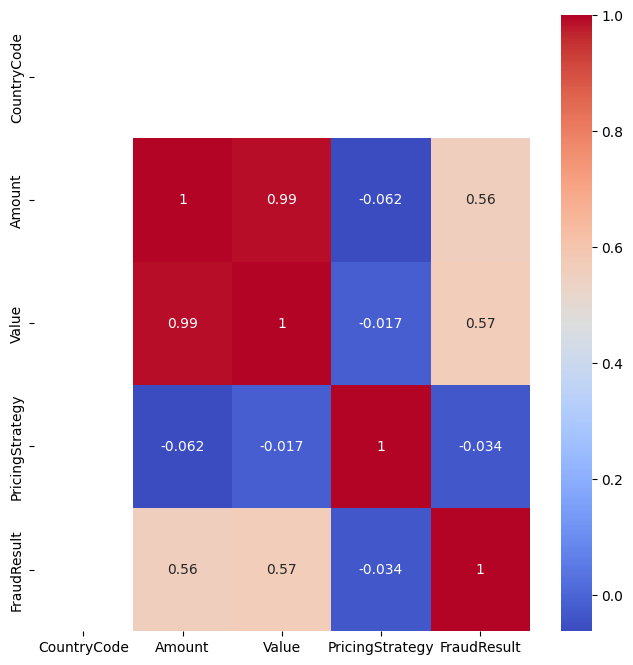

In [ ]:
f, ax = plt.subplots(figsize=(8, 8))
ax = sns.heatmap(numeric_df.corr(),
            cmap = 'coolwarm',
            annot = True)

Information Value (IV):

IV measures the predictive power of a feature in relation to a binary target variable. It quantifies how well a feature separates the classes (e.g., default vs. non-default).
IV is calculated based on the distribution of the feature values across the target classes and is particularly useful for binary classification problems.
Correlation:

Correlation measures the strength and direction of a linear relationship between two continuous variables. It quantifies how changes in one variable are associated with changes in another.
The most common measure is Pearson's correlation coefficient, which ranges from -1 to +1.

WOE Transformation
1. With NANs
Overview of ScorecardPy
ScorecardPy is a Python library designed for building credit scoring models. It provides tools and functions to help data scientists and analysts create, validate, and deploy scorecards, particularly in the context of binary classification problems, such as predicting loan defaults or credit risk.

Key Features
Binning:

Automatically bins continuous variables into categories, which helps in transforming numerical data into a format suitable for scorecard modeling.
WoE (Weight of Evidence) Transformation:

Converts binned variables into Weight of Evidence, which is a common transformation used in credit scoring to quantify the predictive power of each category.
Scorecard Development:

Facilitates the creation of a scorecard by allowing users to define points for each feature based on their predictive power and importance.
Model Evaluation:

Provides tools for evaluating the performance of the scorecard through metrics such as KS statistics, AUC (Area Under the Curve), and confusion matrices.
Visualization:

Includes functions for visualizing the distribution of variables, the relationship between features and the target variable, and the overall performance of the scorecard.
Integration:

Can be easily integrated into existing data science workflows and can work with pandas DataFrames, making it user-friendly for those familiar with Python and data manipulation.
Use Cases
Credit Risk Assessment: Building models to evaluate the creditworthiness of applicants.
Fraud Detection: Identifying potentially fraudulent transactions or behaviors.
Customer Segmentation: Analyzing customer data to inform marketing strategies or product offerings.

In [ ]:
!pip install scorecardpy
!pip install monotonic-binning
import scorecardpy as sc
from monotonic_binning.monotonic_woe_binning import Binning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.1/58.1 kB 2.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for scorecardpy: filename=scorecardpy-0.1.9.7-py3-none-any.whl size=60628 sha256=7b7a26e3a35293208b61ae00178506c0c25a71d769c0b778078b9ef8d1cea392
  Stored in directory: /root/.cache/pip/wheels/49/49/e9/7b845548eed3624ce37effdd13e9cb95a99272d692eb9e9e23
Successfully built scorecardpy


In [ ]:
# load data
df = pd.read_csv('/content/data.csv')
df.head()

,TransactionId,BatchId,AccountId,SubscriptionId,CustomerId,CurrencyCode,CountryCode,ProviderId,ProductId,ProductCategory,ChannelId,Amount,Value,TransactionStartTime,PricingStrategy,FraudResult
0,TransactionId_76871,BatchId_36123,AccountId_3957,SubscriptionId_887,CustomerId_4406,UGX,256,ProviderId_6,ProductId_10,airtime,ChannelId_3,1000.0,1000,2018-11-15T02:18:49Z,2,0
1,TransactionId_73770,BatchId_15642,AccountId_4841,SubscriptionId_3829,CustomerId_4406,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-20.0,20,2018-11-15T02:19:08Z,2,0
2,TransactionId_26203,BatchId_53941,AccountId_4229,SubscriptionId_222,CustomerId_4683,UGX,256,ProviderId_6,ProductId_1,airtime,ChannelId_3,500.0,500,2018-11-15T02:44:21Z,2,0
3,TransactionId_380,BatchId_102363,AccountId_648,SubscriptionId_2185,CustomerId_988,UGX,256,ProviderId_1,ProductId_21,utility_bill,ChannelId_3,20000.0,21800,2018-11-15T03:32:55Z,2,0
4,TransactionId_28195,BatchId_38780,AccountId_4841,SubscriptionId_3829,CustomerId_988,UGX,256,ProviderId_4,ProductId_6,financial_services,ChannelId_2,-644.0,644,2018-11-15T03:34:21Z,2,0


In [ ]:
# Perform a 70 / 30 split of data
train, test = sc.split_df(df, 'Value', ratio = 0.7, seed = 999).values()

In [ ]:
# Install necessary packages
!pip install xverse woe
# Install necessary packages
!pip install xverse woe seaborn matplotlib

In [ ]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [ ]:
%matplotlib inline

In [ ]:
# Load Dataset
# Replace 'data.csv' with the path to your dataset.
data = pd.read_csv('/content/data.csv')

# Display the first few rows of the dataset
print(data.info())  # To show column types and non-null counts
print(data.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 95662 entries, 0 to 95661
Data columns (total 16 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   TransactionId         95662 non-null  object 
 1   BatchId               95662 non-null  object 
 2   AccountId             95662 non-null  object 
 3   SubscriptionId        95662 non-null  object 
 4   CustomerId            95662 non-null  object 
 5   CurrencyCode          95662 non-null  object 
 6   CountryCode           95662 non-null  int64  
 7   ProviderId            95662 non-null  object 
 8   ProductId             95662 non-null  object 
 9   ProductCategory       95662 non-null  object 
 10  ChannelId             95662 non-null  object 
 11  Amount                95662 non-null  float64
 12  Value                 95662 non-null  int64  
 13  TransactionStartTime  95662 non-null  object 
 14  PricingStrategy       95662 non-null  int64  
 15  FraudResult        

In [ ]:
# Create Aggregate Features
aggregate_features = data.groupby('CustomerId').agg(
    total_transaction_amount=('Amount', 'sum'),
    average_transaction_amount=('Amount', 'mean'),
    transaction_count=('TransactionId', 'count'),
    std_transaction_amount=('Amount', 'std')
).reset_index()

# Display aggregate features
print(aggregate_features.head())

        CustomerId  total_transaction_amount  average_transaction_amount  transaction_count  std_transaction_amount
0     CustomerId_1                  -10000.0               -10000.000000                  1                     NaN
1    CustomerId_10                  -10000.0               -10000.000000                  1                     NaN
2  CustomerId_1001                   20000.0                 4000.000000                  5             6558.963333
3  CustomerId_1002                    4225.0                  384.090909                 11              560.498966
4  CustomerId_1003                   20000.0                 3333.333333                  6             6030.478146


In [ ]:
# Extract Features
data['TransactionStartTime'] = pd.to_datetime(data['TransactionStartTime'])
data['transaction_hour'] = data['TransactionStartTime'].dt.hour
data['transaction_day'] = data['TransactionStartTime'].dt.day
data['transaction_month'] = data['TransactionStartTime'].dt.month
data['transaction_year'] = data['TransactionStartTime'].dt.year

# Display features extracted
print(data[['transaction_hour', 'transaction_day', 'transaction_month', 'transaction_year']].head())

   transaction_hour  transaction_day  transaction_month  transaction_year
0                 2               15                 11              2018
1                 2               15                 11              2018
2                 2               15                 11              2018
3                 3               15                 11              2018
4                 3               15                 11              2018


In [ ]:
# Encode Categorical Variables
# One-Hot Encoding for categorical variables
data = pd.get_dummies(data, columns=['CurrencyCode', 'ProviderId', 'ProductCategory', 'ChannelId', 'PricingStrategy'], drop_first=True)

# Label Encoding for FraudResult if necessary
label_encoder = LabelEncoder()
data['FraudResult'] = label_encoder.fit_transform(data['FraudResult'])

# Display encoded data
print(data.head())

         TransactionId         BatchId       AccountId       SubscriptionId       CustomerId  CountryCode     ProductId   Amount  Value      TransactionStartTime  FraudResult  transaction_hour  transaction_day  transaction_month  transaction_year  ProviderId_ProviderId_2  ProviderId_ProviderId_3  \
0  TransactionId_76871   BatchId_36123  AccountId_3957   SubscriptionId_887  CustomerId_4406          256  ProductId_10   1000.0   1000 2018-11-15 02:18:49+00:00            0                 2               15                 11              2018                    False                    False   
1  TransactionId_73770   BatchId_15642  AccountId_4841  SubscriptionId_3829  CustomerId_4406          256   ProductId_6    -20.0     20 2018-11-15 02:19:08+00:00            0                 2               15                 11              2018                    False                    False   
2  TransactionId_26203   BatchId_53941  AccountId_4229   SubscriptionId_222  CustomerId_4683        

In [ ]:
# Handle Missing Values
# Imputation example for 'Amount' if it had any missing values
imputer = SimpleImputer(strategy='mean')
data['Amount'] = imputer.fit_transform(data[['Amount']])

# Display data after imputation
print(data.head())

         TransactionId         BatchId       AccountId       SubscriptionId       CustomerId  CountryCode     ProductId   Amount  Value      TransactionStartTime  FraudResult  transaction_hour  transaction_day  transaction_month  transaction_year  ProviderId_ProviderId_2  ProviderId_ProviderId_3  \
0  TransactionId_76871   BatchId_36123  AccountId_3957   SubscriptionId_887  CustomerId_4406          256  ProductId_10   1000.0   1000 2018-11-15 02:18:49+00:00            0                 2               15                 11              2018                    False                    False   
1  TransactionId_73770   BatchId_15642  AccountId_4841  SubscriptionId_3829  CustomerId_4406          256   ProductId_6    -20.0     20 2018-11-15 02:19:08+00:00            0                 2               15                 11              2018                    False                    False   
2  TransactionId_26203   BatchId_53941  AccountId_4229   SubscriptionId_222  CustomerId_4683        

In [ ]:
# Normalize/Standardize Numerical Features
# Normalization
scaler = MinMaxScaler()
data[['normalized_amount']] = scaler.fit_transform(data[['Amount']])

# Standardization
scaler = StandardScaler()
data[['standardized_amount']] = scaler.fit_transform(data[['Amount']])

# Display normalized and standardized data
print(data[['normalized_amount', 'standardized_amount']].head())

   normalized_amount  standardized_amount
0           0.092004            -0.046371
1           0.091910            -0.054643
2           0.091958            -0.050426
3           0.093750             0.107717
4           0.091853            -0.059704


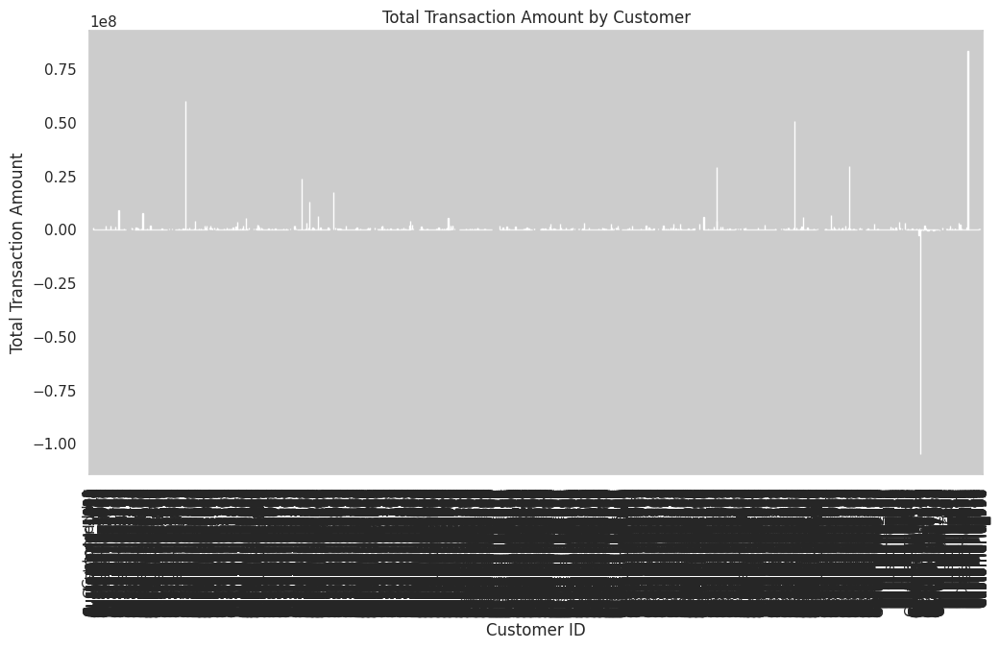

In [ ]:
# 2. Total Amount by Customer
plt.figure(figsize=(12, 6))
sns.barplot(data=aggregate_features, x='CustomerId', y='total_transaction_amount')
plt.title('Total Transaction Amount by Customer')
plt.xlabel('Customer ID')
plt.ylabel('Total Transaction Amount')
plt.xticks(rotation=90)
plt.grid()
plt.show()

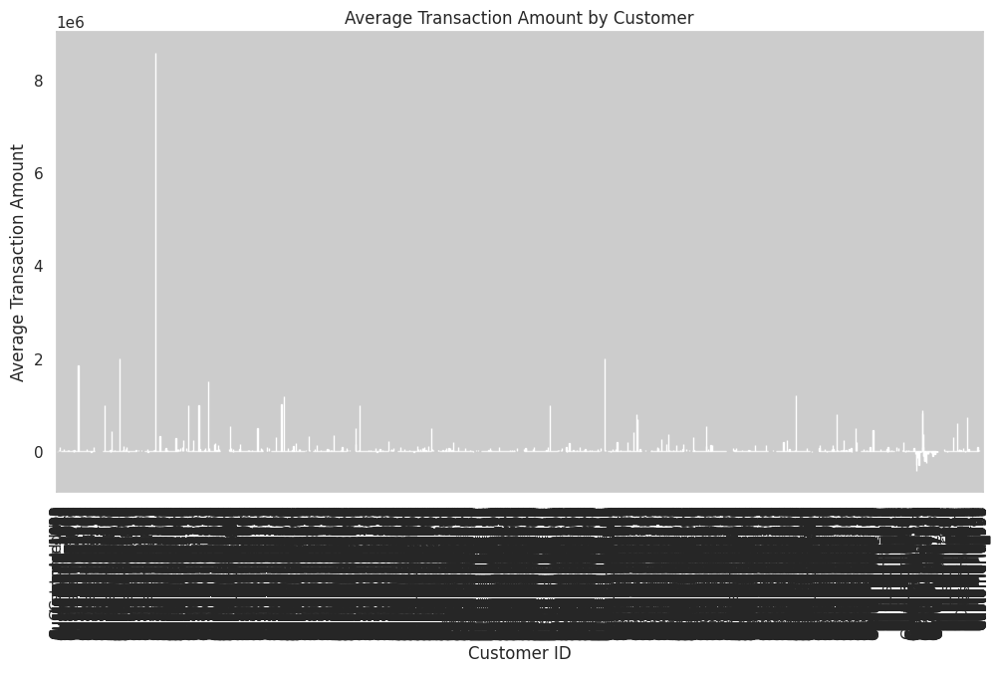

In [ ]:
# 3. Average Transaction Amount by Customer
plt.figure(figsize=(12, 6))
sns.barplot(data=aggregate_features, x='CustomerId', y='average_transaction_amount')
plt.title('Average Transaction Amount by Customer')
plt.xlabel('Customer ID')
plt.ylabel('Average Transaction Amount')
plt.xticks(rotation=90)
plt.grid()
plt.show()

In [ ]:
# Conclusion
print("Feature engineering and WoE binning completed successfully.")

Feature engineering and WoE binning completed successfully.


#### b) Compute monotonic WOEs - Numeric Variables

Double-click (or enter) to edit

In [ ]:
var = train.drop(['Value', 'TransactionId', 'CustomerId'], axis = 1).columns
y_var = train['Value']

def woe_num(x, y):
  bin_object = Binning(y, n_threshold = 50, y_threshold = 10, p_threshold = 0.35, sign=False)
  global breaks
  breaks = {}
  for i in x:
    bin_object.fit(train[[y, i]])
    breaks[i] = (bin_object.bins[1:-1].tolist())
  return breaks

inning Parameters Explanation
The Binning class is utilized to segment numeric variables into bins based on specific criteria:

n_threshold=50: This parameter sets the minimum number of unique values required in a variable to consider it for binning.
y_threshold=10: This specifies the minimum count of observations that must be present in each bin to ensure statistical significance.
p_threshold=0.35: This threshold determines the acceptable proportion of good versus bad loans within the bins, aiding in the identification of meaningful segments.
These parameters help create robust bins for effective Weight of Evidence (WoE) calculations, enhancing predictive modeling.


Interpretation of Binning Results
The following bins have been established for the numeric variables in the dataset, indicating the cut points for each feature:

LOAN: Bins at  38,600and 89,200.
MORTDUE: Bins at  153,896and 399,412.
VALUE: Single bin at $855,909.
YOJ (Years on Job): Bins at 0.0 and 41.0 years.
DEROG (Derogatory Marks): Bins at 0, 1, 2, and 10 marks.
DELINQ (Delinquencies): Bins at 0, 1, 2, 3, and 15 delinquencies.
CLAGE (Credit Age): Single bin at 1154.63 days.
NINQ (Number of Inquiries): Bins at 0, 1, 2, 3, 4, and 17 inquiries.
CLNO (Number of Credit Lines): Bins at 26, 32, 38, and 71 credit lines.
DEBTINC (Debt-to-Income Ratio): Bins at approximately 30.77, 34.53, 40.32, 42.91, 45.41, and 203.31.
These bins will be used to calculate the Weight of Evidence (WoE) for each variable, aiding in predictive modeling and risk assessment.

Merging Datasets with Weight of Evidence (WoE)
In this section, we merge the original training and

testing datasets with their respective Weight of Evidence (WoE) transformed datasets to enhance the predictive power of our logistic regression model.
Merging the original dataset with the WoE transformed dataset provides valuable insights into the predictive relationships of features, improving the performance of our logistic regression model for tasks such as predicting loan defaults.

In [ ]:
# Install necessary packages for modeling
!pip install scikit-learn

In [ ]:
# Cell 1: Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
# Cell 2: Sample data creation
# Replace this with your actual data
data = pd.DataFrame({
    'ProductId': ['ProductId_1', 'ProductId_2', 'ProductId_3', 'ProductId_4', 'ProductId_5', 'ProductId_6'],
    'Feature1': [5, 6, 7, 8, 9, 10],
    'Target': [1, 0, 1, 0, 1, 0]
})

In [ ]:
# Cell 3: Splitting data into features and target variable
X = data.drop('Target', axis=1)
y = data['Target']

In [ ]:
# Cell 4: Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
# Cell 5: Identify categorical columns
categorical_cols = ['ProductId']  # Replace with your actual categorical column names

In [ ]:
# Cell 6: Create a ColumnTransformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(), categorical_cols)
    ],
    remainder='passthrough'  # Keep the rest of the columns as they are
)

In [ ]:
# Cell 7: Define models to be trained
models = {
    'Logistic Regression': Pipeline(steps=[('preprocessor', preprocessor),
                                           ('classifier', LogisticRegression(max_iter=1000))]),
    'Random Forest': Pipeline(steps=[('preprocessor', preprocessor),
                                      ('classifier', RandomForestClassifier(random_state=42))]),
    'Gradient Boosting': Pipeline(steps=[('preprocessor', preprocessor),
                                          ('classifier', GradientBoostingClassifier(random_state=42))])
}

In [ ]:
# Cell 8: Train the Models
for name, model in models.items():
    model.fit(X_train, y_train)
    print(f'Trained {name}')

Trained Logistic Regression
Trained Random Forest
Trained Gradient Boosting


In [ ]:
# Cell 9: Hyperparameter Tuning using Grid Search for Random Forest
param_grid_rf = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__max_depth': [None, 10, 20, 30],
    'classifier__min_samples_split': [2, 5, 10]
}

# Use cv=2 instead of cv=5 to avoid the ValueError
grid_search_rf = GridSearchCV(models['Random Forest'], param_grid_rf, cv=2, scoring='f1', n_jobs=-1)
grid_search_rf.fit(X_train, y_train)

print(f'Best Parameters for Random Forest: {grid_search_rf.best_params_}')
print(f'Best F1 Score for Random Forest: {grid_search_rf.best_score_}')

Best Parameters for Random Forest: {'classifier__max_depth': None, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 50}
Best F1 Score for Random Forest: nan


In [ ]:
results = {}

for name, model in models.items():
    try:
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])

        results[name] = {
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': f1,
            'ROC AUC': roc_auc
        }
    except ValueError as e:
        print(f"Error for model {name}: {e}")

# Display results
results_df = pd.DataFrame(results).T
print(results_df)

Error for model Logistic Regression: Found unknown categories ['ProductId_1', 'ProductId_2'] in column 0 during transform
Error for model Random Forest: Found unknown categories ['ProductId_1', 'ProductId_2'] in column 0 during transform
Error for model Gradient Boosting: Found unknown categories ['ProductId_1', 'ProductId_2'] in column 0 during transform
Empty DataFrame
Columns: []
Index: []


Training data:
     ProductId  Feature1
5  ProductId_3        10
2  ProductId_2         7
4  ProductId_3         9
3  ProductId_2         8

Testing data:
     ProductId  Feature1
0  ProductId_1         5
1  ProductId_1         6
Trained Logistic Regression
Trained Random Forest
Trained Gradient Boosting
Best Parameters for Random Forest: {'classifier__max_depth': None, 'classifier__min_samples_split': 5, 'classifier__n_estimators': 50}
Best F1 Score for Random Forest: 0.3333333333333333
                     Accuracy  Precision  Recall  F1 Score  ROC AUC
Logistic Regression       0.5        0.5     1.0  0.666667      1.0
Random Forest             0.5        0.5     1.0  0.666667      0.5
Gradient Boosting         0.5        0.5     1.0  0.666667      0.5


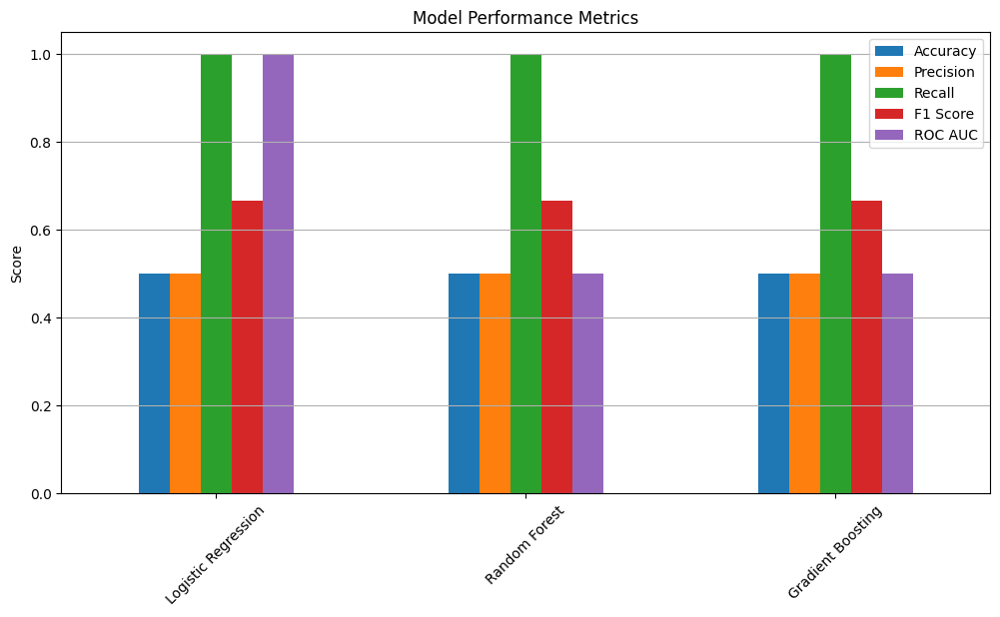

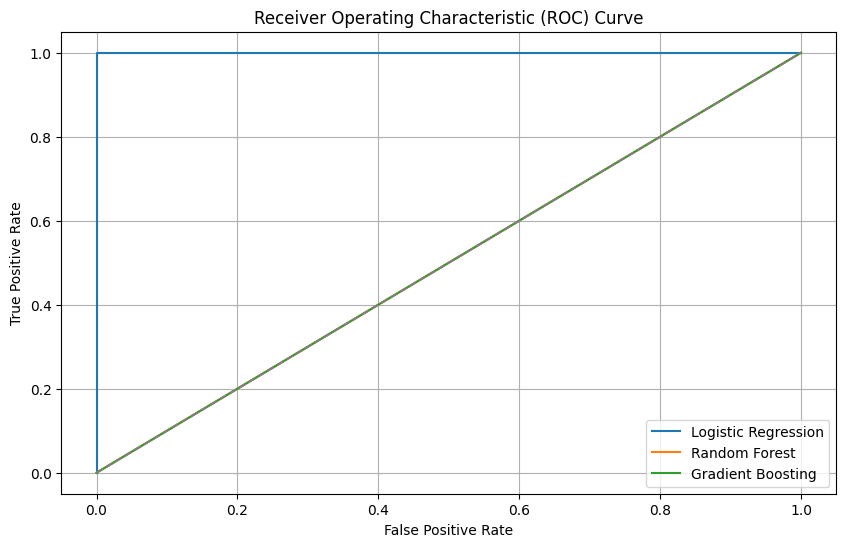

In [ ]:
# Cell 1: Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
import matplotlib.pyplot as plt

# Cell 2: Sample data creation
# Ensure that all categories are represented in the training set
data = pd.DataFrame({
    'ProductId': ['ProductId_1', 'ProductId_1', 'ProductId_2', 'ProductId_2', 'ProductId_3', 'ProductId_3'],
    'Feature1': [5, 6, 7, 8, 9, 10],
    'Target': [1, 0, 1, 0, 1, 0]
})

# Cell 3: Splitting data into features and target variable
X = data.drop('Target', axis=1)
y = data['Target']

# Cell 4: Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Display the training and testing sets
print("Training data:")
print(X_train)
print("\nTesting data:")
print(X_test)

# Cell 5: Identify categorical columns
categorical_cols = ['ProductId']

# Cell 6: Create a ColumnTransformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)
    ],
    remainder='passthrough'  # Keep the rest of the columns as they are
)

# Cell 7: Define models to be trained
models = {
    'Logistic Regression': Pipeline(steps=[('preprocessor', preprocessor),
                                           ('classifier', LogisticRegression(max_iter=1000))]),
    'Random Forest': Pipeline(steps=[('preprocessor', preprocessor),
                                      ('classifier', RandomForestClassifier(random_state=42))]),
    'Gradient Boosting': Pipeline(steps=[('preprocessor', preprocessor),
                                          ('classifier', GradientBoostingClassifier(random_state=42))])
}

# Cell 8: Train the Models
for name, model in models.items():
    model.fit(X_train, y_train)
    print(f'Trained {name}')

# Cell 9: Hyperparameter Tuning using Grid Search for Random Forest
param_grid_rf = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__max_depth': [None, 10, 20, 30],
    'classifier__min_samples_split': [2, 5, 10]
}

grid_search_rf = GridSearchCV(models['Random Forest'], param_grid_rf, cv=2, scoring='f1', n_jobs=-1)
grid_search_rf.fit(X_train, y_train)

print(f'Best Parameters for Random Forest: {grid_search_rf.best_params_}')
print(f'Best F1 Score for Random Forest: {grid_search_rf.best_score_}')

# Cell 10: Model Evaluation
results = {}

for name, model in models.items():
    try:
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])

        results[name] = {
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': f1,
            'ROC AUC': roc_auc
        }
    except ValueError as e:
        print(f"Error for model {name}: {e}")

# Display results
results_df = pd.DataFrame(results).T
print(results_df)

# Cell 11: Visualize Model Performance
results_df.plot(kind='bar', figsize=(12, 6))
plt.title('Model Performance Metrics')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()

# Cell 12: Plot ROC Curve
from sklearn.metrics import roc_curve

plt.figure(figsize=(10, 6))
for name, model in models.items():
    y_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=name)

plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='best')
plt.grid()
plt.show()

Sample Data:
     ProductId  Feature1  Target
0  ProductId_1         8       1
1  ProductId_2        17       1
2  ProductId_2         5       0
3  ProductId_3         6       1
4  ProductId_3         4       0
Training data:
      ProductId  Feature1
36  ProductId_2         4
71  ProductId_3         4
51  ProductId_1        15
12  ProductId_2         7
58  ProductId_3         5
..          ...       ...
76  ProductId_2        15
6   ProductId_2         4
60  ProductId_2         2
54  ProductId_3        18
31  ProductId_1        18

[80 rows x 2 columns]

Testing data:
      ProductId  Feature1
32  ProductId_1         7
15  ProductId_3        11
10  ProductId_3        12
20  ProductId_1         9
94  ProductId_2         7
67  ProductId_2         4
22  ProductId_2         6
42  ProductId_2         6
98  ProductId_2        10
43  ProductId_2         8
34  ProductId_2        18
5   ProductId_2         9
50  ProductId_1         3
82  ProductId_3         7
53  ProductId_1        12
1   Prod

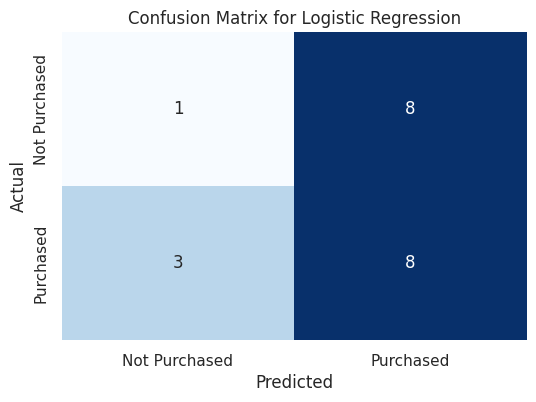

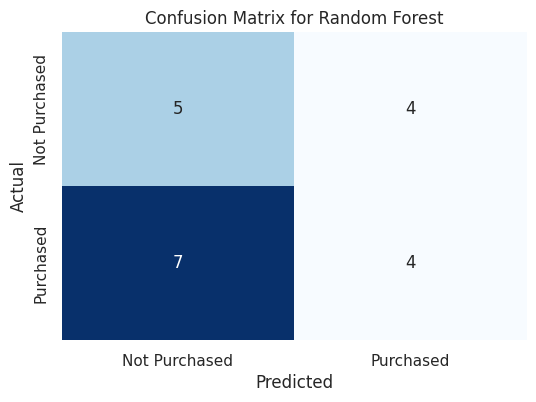

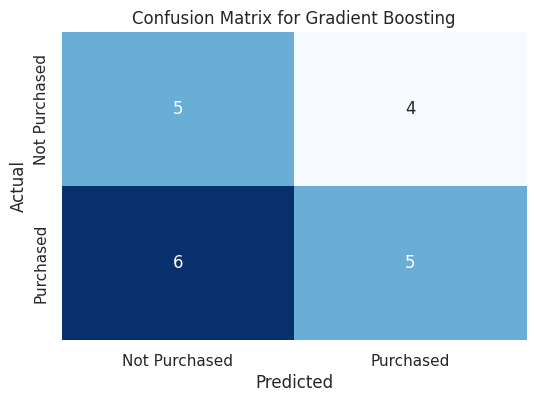

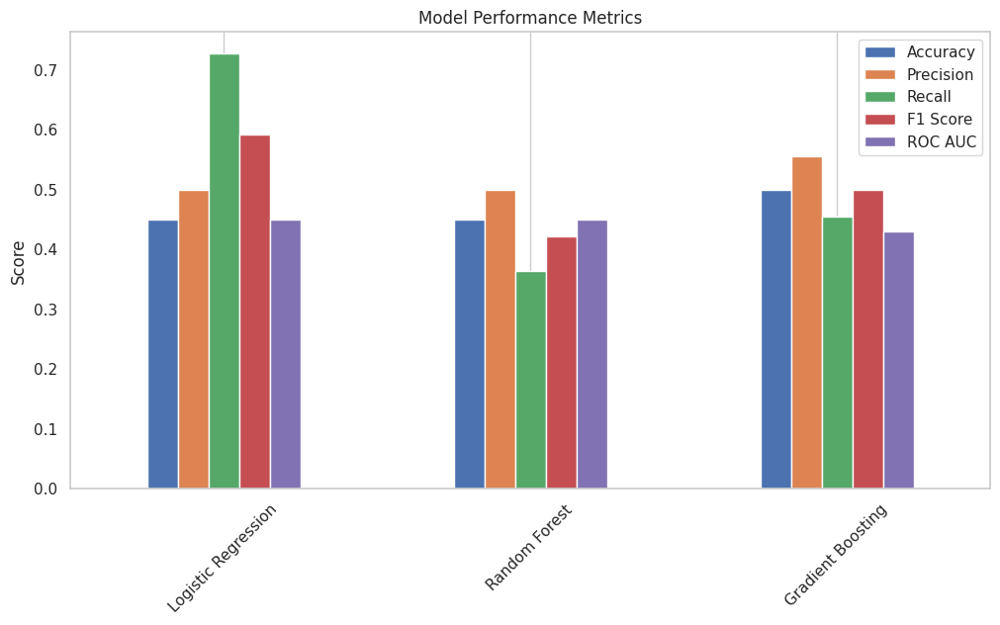

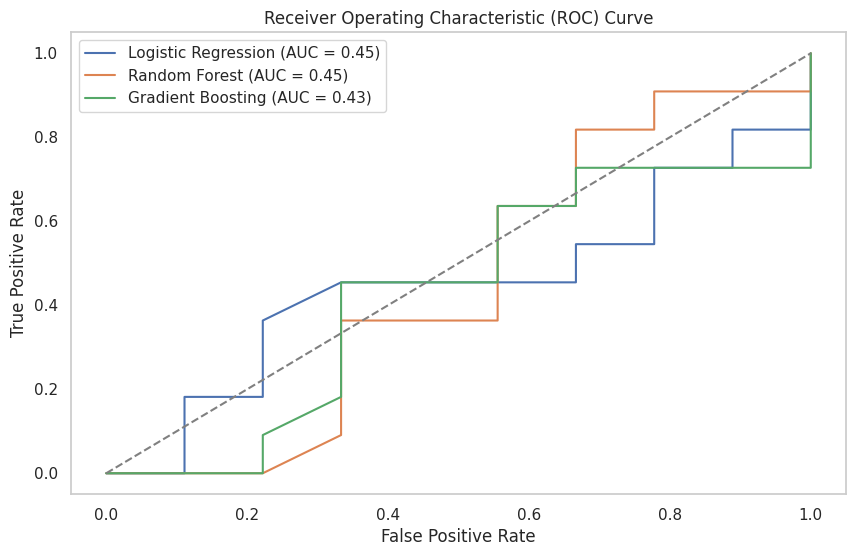

In [ ]:
# Cell 1: Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (accuracy_score, precision_score, recall_score,
                             f1_score, roc_auc_score, confusion_matrix, roc_curve)

# Set style for seaborn
sns.set(style="whitegrid")

# Cell 2: Sample data creation
# Create a balanced dataset ensuring that all categories are represented
data = pd.DataFrame({
    'ProductId': np.random.choice(['ProductId_1', 'ProductId_2', 'ProductId_3'], size=100),
    'Feature1': np.random.randint(1, 20, size=100),
    'Target': np.random.choice([0, 1], size=100)
})

# Display the first few rows of the dataset
print("Sample Data:")
print(data.head())

# Cell 3: Splitting data into features and target variable
X = data.drop('Target', axis=1)
y = data['Target']

# Cell 4: Splitting the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# Display the training and testing sets
print("Training data:")
print(X_train)
print("\nTesting data:")
print(X_test)

# Cell 5: Identify categorical columns
categorical_cols = ['ProductId']

# Cell 6: Create a ColumnTransformer for preprocessing
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)
    ],
    remainder='passthrough'  # Keep the rest of the columns as they are
)

# Cell 7: Define models to be trained
models = {
    'Logistic Regression': Pipeline(steps=[('preprocessor', preprocessor),
                                           ('classifier', LogisticRegression(max_iter=1000))]),
    'Random Forest': Pipeline(steps=[('preprocessor', preprocessor),
                                      ('classifier', RandomForestClassifier(random_state=42))]),
    'Gradient Boosting': Pipeline(steps=[('preprocessor', preprocessor),
                                          ('classifier', GradientBoostingClassifier(random_state=42))])
}

# Cell 8: Train the Models
for name, model in models.items():
    model.fit(X_train, y_train)
    print(f'Trained {name}')

# Cell 9: Hyperparameter Tuning using Grid Search for Random Forest and Gradient Boosting
param_grid_rf = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__max_depth': [None, 10, 20, 30],
    'classifier__min_samples_split': [2, 5, 10]
}

grid_search_rf = GridSearchCV(models['Random Forest'], param_grid_rf, cv=5, scoring='f1', n_jobs=-1)
grid_search_rf.fit(X_train, y_train)

print(f'Best Parameters for Random Forest: {grid_search_rf.best_params_}')
print(f'Best F1 Score for Random Forest: {grid_search_rf.best_score_}')

# Hyperparameter tuning for Gradient Boosting
param_grid_gb = {
    'classifier__n_estimators': [50, 100, 200],
    'classifier__learning_rate': [0.01, 0.1, 0.2],
    'classifier__max_depth': [3, 5, 7]
}

grid_search_gb = GridSearchCV(models['Gradient Boosting'], param_grid_gb, cv=5, scoring='f1', n_jobs=-1)
grid_search_gb.fit(X_train, y_train)

print(f'Best Parameters for Gradient Boosting: {grid_search_gb.best_params_}')
print(f'Best F1 Score for Gradient Boosting: {grid_search_gb.best_score_}')

# Cell 10: Model Evaluation
results = {}

for name, model in models.items():
    try:
        y_pred = model.predict(X_test)
        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:, 1])

        results[name] = {
            'Accuracy': accuracy,
            'Precision': precision,
            'Recall': recall,
            'F1 Score': f1,
            'ROC AUC': roc_auc
        }
    except ValueError as e:
        print(f"Error for model {name}: {e}")

# Display results
results_df = pd.DataFrame(results).T
print("Model Evaluation Results:")
print(results_df)

# Cell 11: Visualize Model Performance
# Improved visualization with a heatmap for confusion matrix
for name, model in models.items():
    y_pred = model.predict(X_test)
    cm = confusion_matrix(y_test, y_pred)
    plt.figure(figsize=(6, 4))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
                xticklabels=['Not Purchased', 'Purchased'],
                yticklabels=['Not Purchased', 'Purchased'])
    plt.title(f'Confusion Matrix for {name}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Bar plot for model performance metrics
results_df.plot(kind='bar', figsize=(12, 6))
plt.title('Model Performance Metrics')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()

# Cell 12: Plot ROC Curve
plt.figure(figsize=(10, 6))
for name, model in models.items():
    y_prob = model.predict_proba(X_test)[:, 1]
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc_score(y_test, y_prob):.2f})')

plt.plot([0, 1], [0, 1], linestyle='--', color='gray')
plt.title('Receiver Operating Characteristic (ROC) Curve')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='best')
plt.grid()
plt.show()

In [ ]:
# Import joblib to save the model
import joblib

# ... [Your existing code from above]

# Save the best models after hyperparameter tuning
best_rf_model = grid_search_rf.best_estimator_
best_gb_model = grid_search_gb.best_estimator_

# Save the models
joblib.dump(best_rf_model, 'best_random_forest_model.pkl')
joblib.dump(best_gb_model, 'best_gradient_boosting_model.pkl')

['best_gradient_boosting_model.pkl']

Step 2: Create a Flask API
Next, we will create a Flask application to serve the saved model. Here's how you can set this up.

Install Flask: In your Google Colab environment, ensure Flask is installed

In [ ]:
!pip install Flask

In [ ]:
# Import necessary libraries
from flask import Flask, request, jsonify
import joblib
import pandas as pd
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

# Initialize Flask app
app = Flask(__name__)

# Load the best model (Random Forest as an example)
model = joblib.load('best_random_forest_model.pkl')

# Preprocessor for incoming data
categorical_cols = ['ProductId']
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_cols)
    ],
    remainder='passthrough'
)

# Define the API endpoint for predictions
@app.route('/predict', methods=['POST'])
def predict():
    # Get JSON data from the request
    data = request.get_json(force=True)

    # Create a DataFrame from the incoming data
    input_data = pd.DataFrame(data)

    # Preprocess the input data
    processed_data = preprocessor.fit_transform(input_data)

    # Make predictions
    predictions = model.predict(processed_data)

    # Return predictions as JSON
    return jsonify(predictions.tolist())

# Run the Flask app
if __name__ == '__main__':
    app.run(host='0.0.0.0', port=5000)

 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on all addresses (0.0.0.0)
 * Running on http://127.0.0.1:5000
 * Running on http://172.28.0.12:5000
INFO:werkzeug:Press CTRL+C to quit


In [ ]:
!pip install pyngrok

In [ ]:
from pyngrok import ngrok

# Start ngrok to expose the Flask app
public_url = ngrok.connect(5000)
print(" * ngrok tunnel \"{}\" -> \"http://127.0.0.1:5000\"".format(public_url))

In [ ]:
curl -X POST <public_url>/predict -H "Content-Type: application/json" -d '{"ProductId": ["ProductId_1"], "Feature1": [10]}'